In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 23.1 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00:00:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 7.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 80.0 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.9.41
    Uninstalling nvidia-nvjitlink-cu12-12.9.41:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.9.41
  Attempting uninstall: nvidia-curand-cu12
    Found existin

In [2]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import glob
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
model = YOLO('yolo11m.pt')

100%|██████████| 38.8M/38.8M [00:00<00:00, 215MB/s]



image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/479012386aa308fb_jpg.rf.24d80cdb95dae89bc61b36651306c45f.jpg: 640x640 1 bus, 17.8ms
Speed: 12.3ms preprocess, 17.8ms inference, 249.3ms postprocess per image at shape (1, 3, 640, 640)


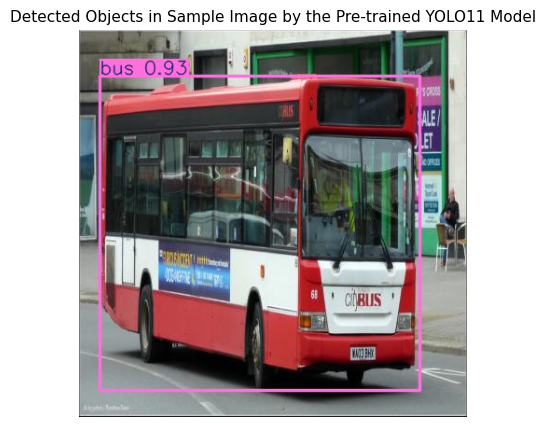

In [4]:
image_path = "/kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/479012386aa308fb_jpg.rf.24d80cdb95dae89bc61b36651306c45f.jpg"

IResualt = model.predict(source =image_path,
                        imgsz = 640,
                        conf = 0.70)
sample = IResualt[0].plot(line_width = 2)
sample = cv2.cvtColor(sample, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(5,10))
plt.imshow(sample)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLO11 Model', fontsize=11)
plt.axis('off')
plt.show()


image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/00dea1edf14f09ab_jpg.rf.3f17c8790a68659d03b1939a59ccda80.jpg: 640x640 1 truck, 20.3ms
Speed: 3.0ms preprocess, 20.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


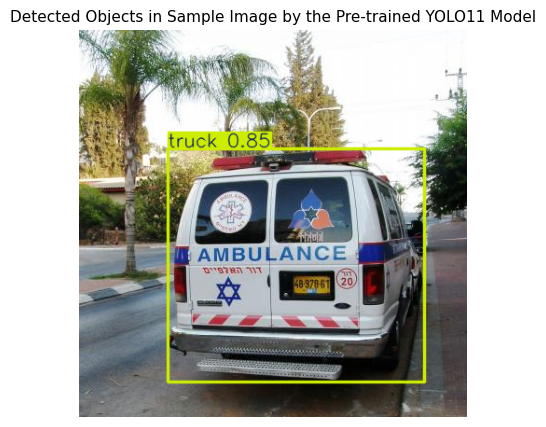

In [5]:
image_path = "/kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/00dea1edf14f09ab_jpg.rf.3f17c8790a68659d03b1939a59ccda80.jpg"

IResualt = model.predict(source =image_path,
                        imgsz = 640,
                        conf = 0.70)
sample = IResualt[0].plot(line_width = 2)
sample = cv2.cvtColor(sample, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(5,10))
plt.imshow(sample)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLO11 Model', fontsize=11)
plt.axis('off')
plt.show()

In [6]:
# Define the dataset_path
dataset_path = '/kaggle/input/vehicledetection/VehiclesDetectionDataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'dataset.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Ambulance
- Bus
- Car
- Motorcycle
- Truck
nc: 5
test: ../test/images
train: ../train/images
val: ../valid/images



In [7]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):  
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'): 
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 878
Number of validation images: 250
All training images have the same size: (416, 416)
All validation images have the same size: (416, 416)


In [9]:
results = model.train(
    data=yaml_file_path,
    epochs=250,
    imgsz=416,
    device=0,
    patience=50,
    batch=16,
    optimizer='auto',
    lr0=0.0005,
    lrf=0.01,
    warmup_epochs=3,
    seed=0,
    show_labels=True,
    val=True
)

Ultralytics 8.3.151 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/vehicledetection/VehiclesDetectionDataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=250, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0005, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=50

train: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/labels... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:01<00:00, 595.90it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.8±0.7 ms, read: 47.5±14.5 MB/s, size: 33.0 KB)


val: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 426.08it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 4 dataloader workers
Logging results to runs/detect/train2
Starting training for 250 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/250      5.05G      1.044      1.178      1.336         42        416: 100%|██████████| 55/55 [00:19<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.63it/s]

                   all        250        454      0.589      0.631      0.585      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/250      5.12G      1.005      1.088      1.288         50        416: 100%|██████████| 55/55 [00:19<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.563      0.491      0.542      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/250      5.25G     0.9565      1.046      1.265         43        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454      0.572      0.495      0.501      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/250      5.32G     0.9736      1.052      1.279         56        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.544       0.55      0.559      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/250      5.38G     0.9378     0.9768      1.257         61        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454       0.57       0.51      0.534      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/250       5.5G     0.9404      1.009      1.261         44        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.527       0.56      0.506      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/250      5.62G     0.9946      1.099       1.29         37        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454      0.579      0.456      0.504       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/250      5.75G     0.9465      1.006      1.257         42        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.559      0.515      0.501      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/250      6.01G     0.9568     0.9858      1.256         37        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.546      0.522      0.516      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/250      6.08G     0.9371     0.9803      1.251         50        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.71it/s]

                   all        250        454      0.661      0.496      0.581      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/250      6.14G     0.9291     0.9599      1.248         52        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454      0.631      0.503      0.559      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/250      6.21G     0.9095     0.9135       1.22         48        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454      0.695      0.454      0.545      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/250      6.29G     0.9055     0.9068      1.225         46        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]

                   all        250        454      0.537      0.642      0.567      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/250      6.41G     0.8758     0.8773      1.197         51        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454      0.655      0.466      0.497       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/250      6.53G     0.8659     0.8484      1.192         54        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.541      0.566      0.571      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/250      6.63G     0.8519     0.8312      1.183         42        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.513      0.641      0.569      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/250      6.75G     0.8382     0.8398      1.181         58        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.575      0.535      0.548      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/250      6.86G     0.8416     0.8306      1.184         69        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454      0.611      0.577      0.593      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/250      6.99G     0.8308     0.8108      1.183         41        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.604       0.61      0.611       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/250       7.1G     0.7936     0.7614      1.146         45        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.553      0.534      0.522      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/250      7.22G      0.845     0.7895      1.176         54        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454      0.615      0.565      0.579      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/250      7.33G     0.7958     0.7881      1.165         64        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454       0.56      0.561      0.568      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/250      7.44G     0.8207     0.7765       1.15         44        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.646      0.583      0.626      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/250      7.58G     0.7834     0.7216       1.14         41        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.597      0.534      0.566      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/250      7.68G     0.7668     0.7042      1.115         41        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.591      0.569      0.553      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/250      7.79G     0.7692     0.7125      1.127         40        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.69it/s]

                   all        250        454      0.609      0.553      0.567      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/250       7.9G     0.7699     0.6914      1.125         41        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.593      0.561      0.568       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/250      8.02G     0.7365     0.7127      1.109         53        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.667      0.538      0.545      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/250      5.25G     0.7543     0.7062      1.116         55        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.733      0.525      0.608      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/250      5.25G     0.7537     0.6935      1.106         53        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.684      0.508      0.569      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/250      5.25G     0.7443     0.6963      1.116         31        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.599      0.631      0.641      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/250      5.25G     0.7352     0.6732      1.095         47        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.568      0.567      0.562      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/250      5.25G     0.7206     0.6601      1.102         49        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.634      0.523      0.548      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/250      5.25G     0.7414     0.6537      1.109         47        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454       0.69       0.48      0.553      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/250      5.25G     0.7136     0.6594      1.092         38        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.539      0.575      0.568      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/250      5.25G     0.7105     0.6496      1.085         47        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.70it/s]

                   all        250        454      0.677      0.499      0.559      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/250      5.25G     0.6919     0.6106      1.063         62        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.639      0.528      0.553      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/250      5.25G     0.6956     0.6223      1.078         43        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.70it/s]

                   all        250        454       0.78      0.491      0.574      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/250      5.29G     0.7041     0.6113      1.077         57        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.644      0.544       0.57      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/250      5.36G     0.6948     0.6107      1.073         46        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all        250        454       0.58      0.553      0.575      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/250      5.73G     0.6823      0.614      1.058         48        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.695      0.508      0.576       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/250      5.79G     0.6629     0.5971      1.066         35        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.571      0.542      0.532      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/250      5.86G     0.6678     0.5879      1.056         52        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.605      0.565      0.569      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/250      5.93G     0.6569      0.581      1.053         36        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.566      0.586      0.578      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/250      5.99G     0.6594     0.5858       1.06         64        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.678      0.483      0.541      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/250      6.06G     0.6432     0.5684       1.05         63        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.656      0.604      0.594      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/250      6.12G     0.6574     0.5692      1.058         57        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.619      0.522      0.572       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/250      6.19G     0.6431     0.5527      1.035         51        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.689       0.52      0.579      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/250      6.26G     0.6393     0.5519      1.032         46        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.661       0.58      0.621      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/250      6.38G     0.6176     0.5608      1.036         61        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.603      0.531      0.558      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/250       6.5G     0.6104     0.5487       1.02         54        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.678      0.488      0.547      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/250      6.63G     0.6339     0.5555      1.042         67        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.68it/s]

                   all        250        454      0.602      0.536      0.572      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/250      6.73G     0.6169     0.5473       1.03         59        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.583      0.556      0.554      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/250      6.85G     0.6092     0.5179      1.025         60        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.684      0.542      0.605      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/250      6.97G     0.6027     0.5299      1.027         55        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.646      0.521      0.593      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/250      7.38G     0.6034     0.5243      1.016         59        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.714      0.512      0.567      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/250      7.45G     0.6252       0.54      1.042         51        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.615      0.531      0.576      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/250      7.52G      0.587     0.5098      1.026         63        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.525      0.544      0.544      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/250      7.58G     0.5996     0.5131      1.023         39        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.553      0.524      0.515      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/250      7.65G     0.5981     0.5003      1.023         64        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.555      0.561       0.56      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/250      7.71G      0.606     0.5311      1.014         56        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.688      0.474      0.563      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/250      7.78G      0.577     0.5093      1.025         30        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.507      0.577      0.537      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/250      7.88G     0.5739     0.4885      1.005         44        416: 100%|██████████| 55/55 [00:19<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.579      0.475      0.524      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/250      7.98G     0.5939      0.504      1.017         52        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.555      0.545      0.552      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/250      4.99G      0.576     0.4792      1.005         70        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.64it/s]

                   all        250        454      0.589      0.546      0.575      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/250      4.99G     0.5688      0.495      1.008         39        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.697      0.478      0.583      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/250      4.99G     0.5517     0.4579     0.9928         75        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.553      0.593      0.583      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/250      4.99G     0.5591     0.4639      1.003         48        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.595      0.553      0.546       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/250      4.99G     0.5544     0.4786     0.9905         48        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.629      0.558      0.563      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/250      4.99G     0.5547     0.4754     0.9888         38        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.579      0.585      0.562      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/250      4.99G     0.5485     0.4685     0.9945         51        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.634      0.534      0.576      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/250      5.03G     0.5444     0.4508     0.9886         52        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.80it/s]

                   all        250        454      0.615      0.544      0.569       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/250      5.07G     0.5384     0.4506     0.9972         43        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.606      0.484      0.526      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/250      5.12G     0.5381     0.4455     0.9828         57        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.76it/s]

                   all        250        454      0.605      0.501      0.536      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/250      5.16G     0.5487     0.4734     0.9888         47        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454      0.695      0.507      0.583      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/250      5.28G     0.5312     0.4366     0.9824         42        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454       0.67       0.55      0.596      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/250      5.38G     0.5377     0.4287     0.9858         61        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.622      0.571      0.585      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/250      5.49G     0.5283     0.4324     0.9754         60        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.673      0.518      0.587      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/250      5.61G     0.5254     0.4544     0.9828         59        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454       0.65      0.611      0.605      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/250      5.75G     0.5364     0.4397     0.9811         55        416: 100%|██████████| 55/55 [00:19<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.646      0.538      0.573      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/250      5.83G     0.5441     0.4442     0.9903         53        416: 100%|██████████| 55/55 [00:18<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.648      0.581      0.586      0.435
EarlyStopping: Training stopped early as no improvement observed in last 50 epochs. Best results observed at epoch 32, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



82 epochs completed in 0.500 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 40.5MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.151 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.63it/s]


                   all        250        454      0.596      0.631      0.641      0.478
             Ambulance         50         64      0.809      0.812      0.868      0.733
                   Bus         30         46      0.641      0.565      0.681       0.56
                   Car         90        238      0.571      0.504      0.518      0.345
            Motorcycle         42         46      0.541      0.739      0.693      0.438
                 Truck         38         60      0.417      0.533      0.442      0.314
Speed: 0.1ms preprocess, 5.6ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
# Define the path to the sample video in the dataset
dataset_video_path = '/kaggle/input/vehicledetection/TestVideo/TrafficPolice.mp4'

# Define the destination path in the working directory
video_path = '/kaggle/input/vehicledetection/TestVideo/TrafficPolice.mp4'

# Initiate vehicle detection on the sample video using the best performing model and save the output
model.predict(source=video_path, save=True)

In [ ]:
Video(video_path, embed=True, width=960)

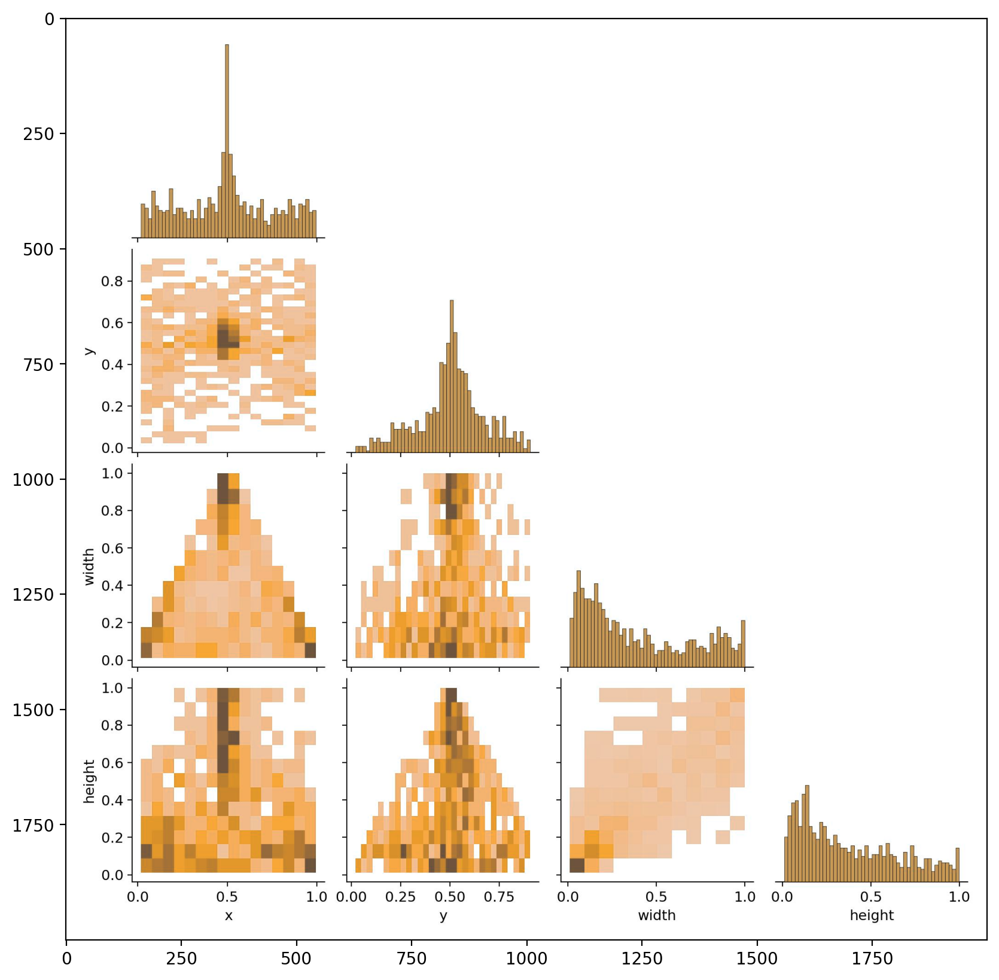

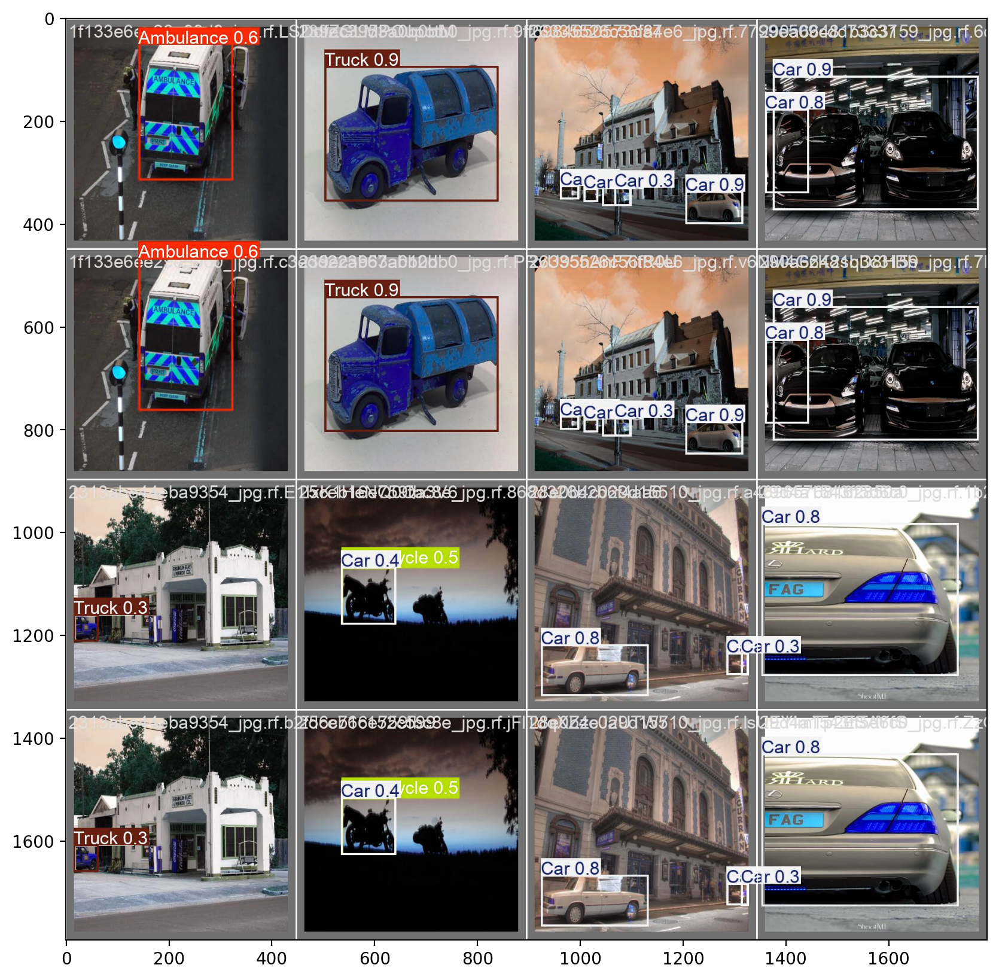

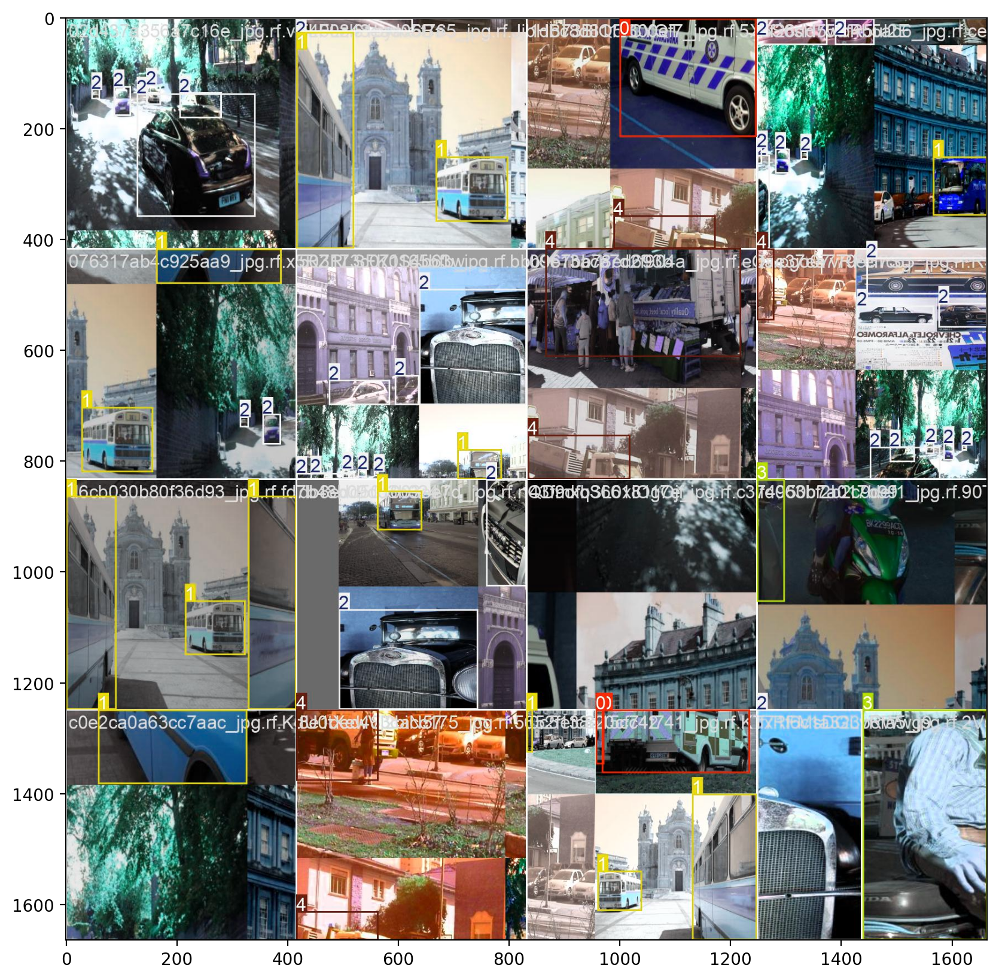

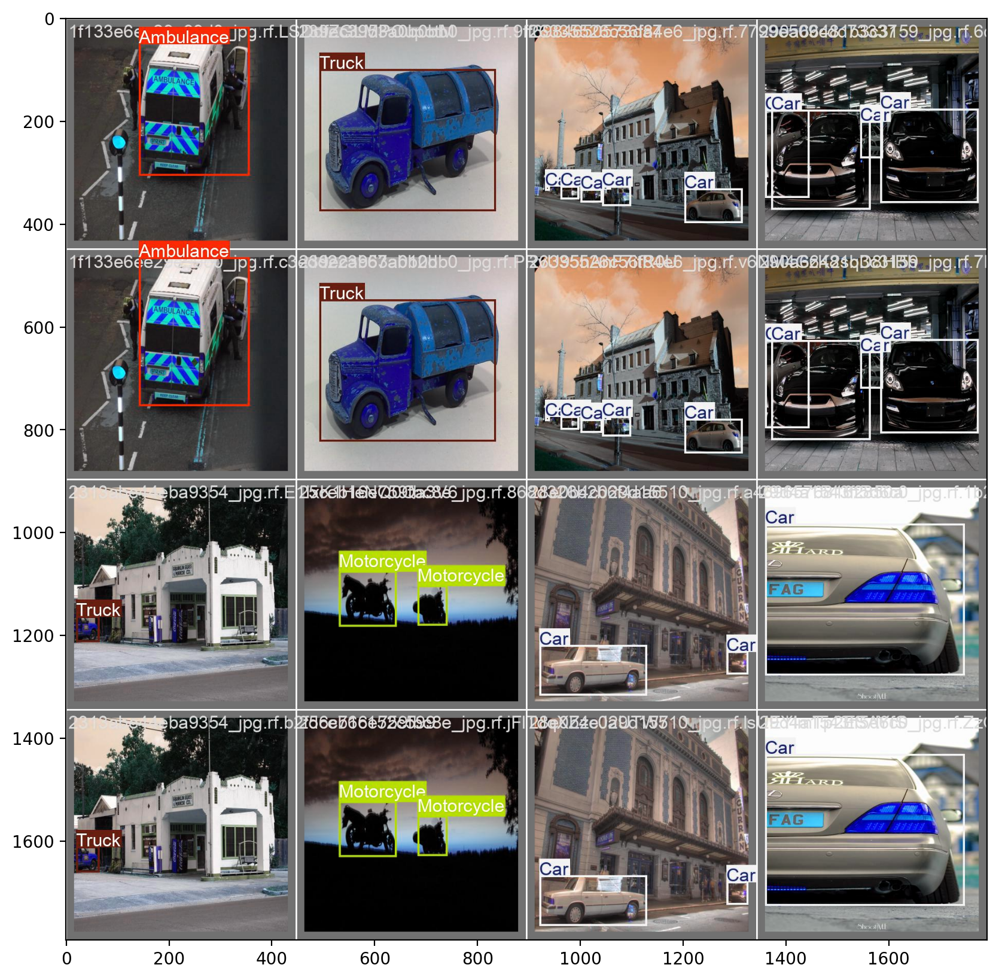

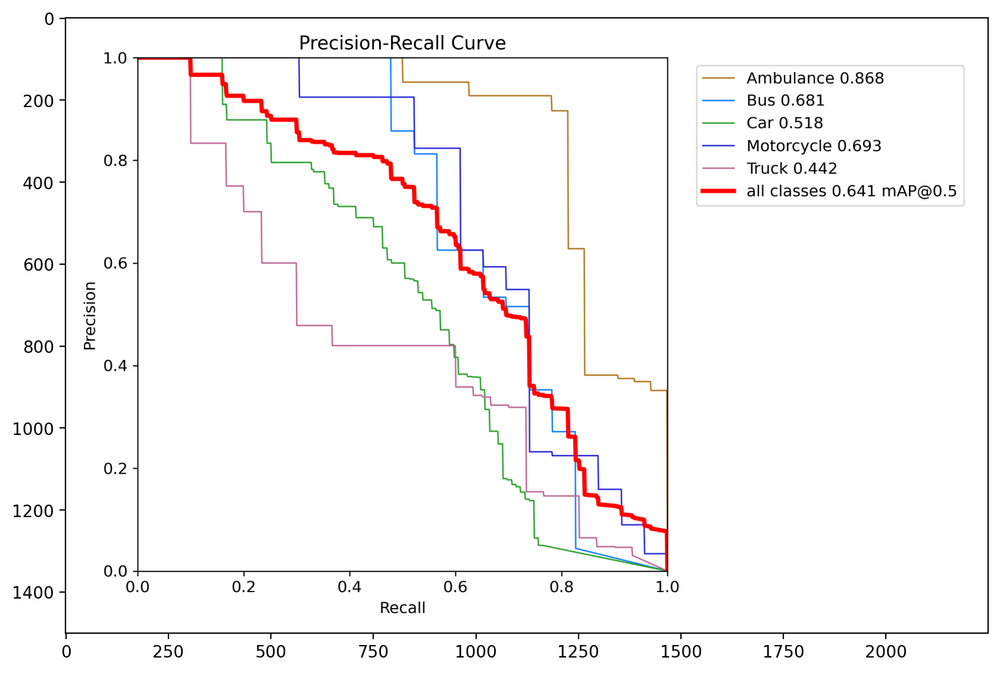

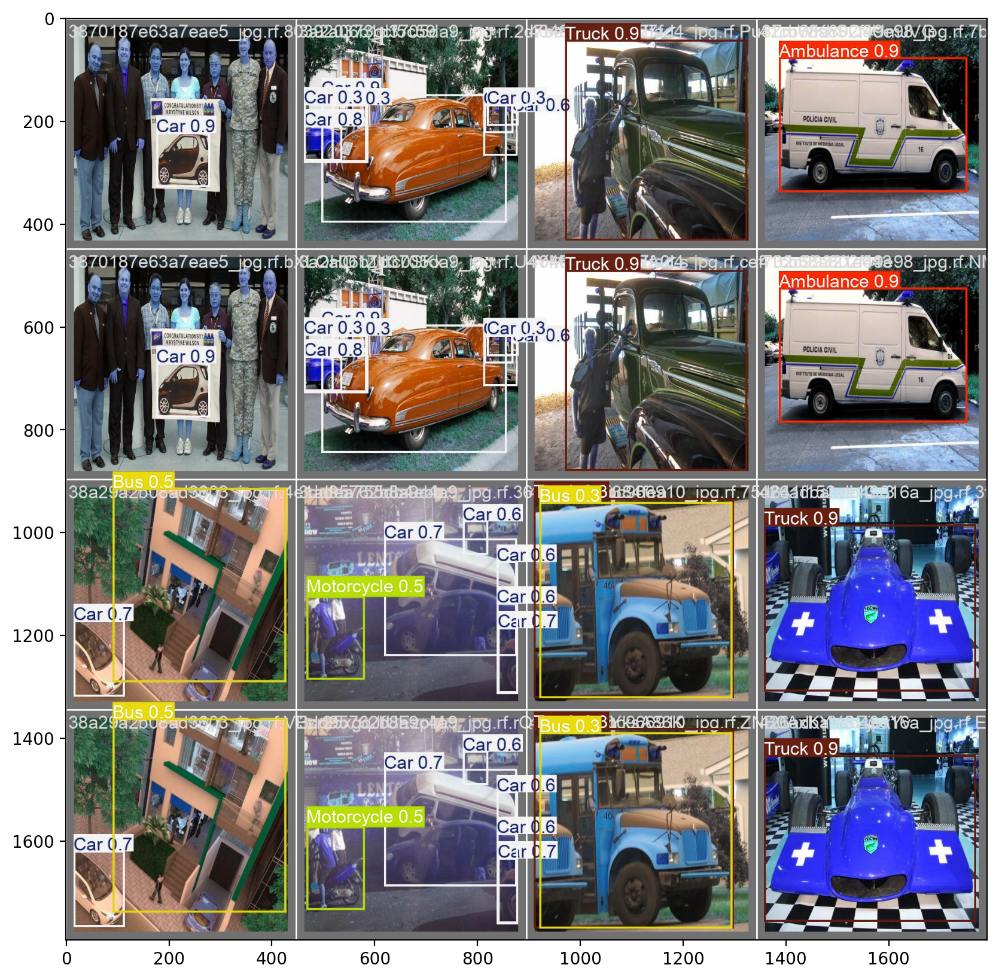

In [ ]:
data_dir = "/kaggle/working/runs/detect/train2"
img_dir = os.path.join(data_dir, '*g')
files = glob.glob(img_dir)
imgs = []
for image in files:
    img = cv2.imread(image)
    imgs.append(img)
    plt.figure(figsize=(10,10), dpi= 200)
    plt.imshow(img)

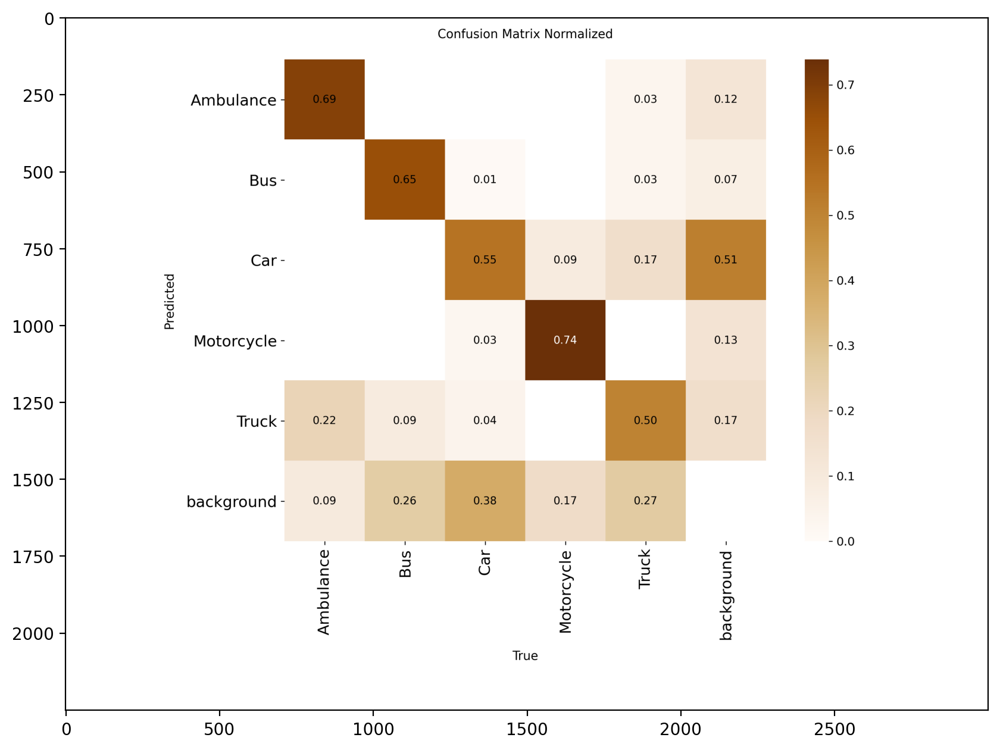

In [15]:
imge = cv2.imread("/kaggle/working/runs/detect/train2/confusion_matrix_normalized.png")
plt.figure(figsize=(10,10), dpi= 200)
plt.imshow(imge)

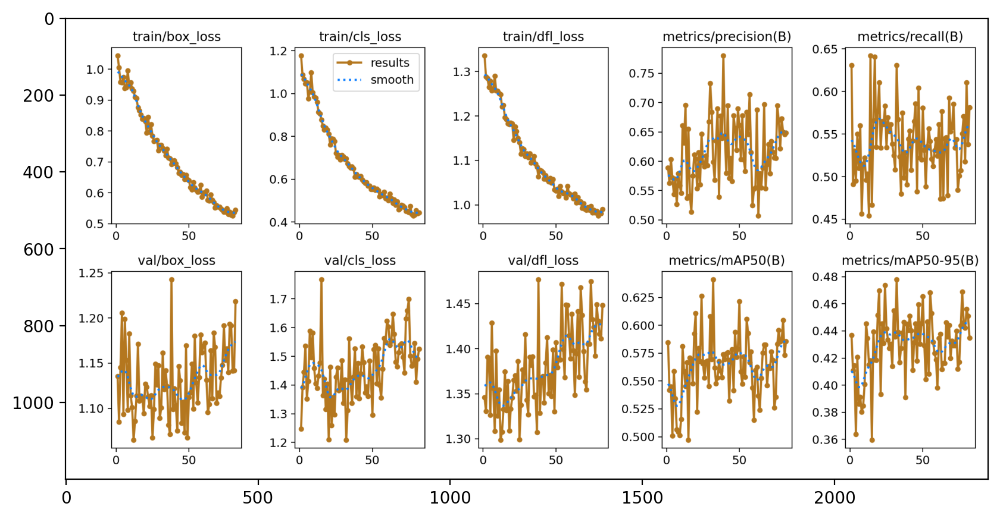

In [16]:
imge = cv2.imread("/kaggle/working/runs/detect/train2/results.png")
plt.figure(figsize=(10,10), dpi= 200)
plt.imshow(imge)